In [1]:
library(Seurat)
library(Matrix)
library(ggplot2)
library(cowplot)
library(dplyr)
library(enrichR)
load('/data/komura//project//scRNA-seq_gastric_cancer//notebooks/Normal_Total_gastric.RData')


Attaching package: ‘cowplot’

The following object is masked from ‘package:ggplot2’:

    ggsave


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



In [2]:
# geneの発現量の平均値をとる
AddGeneSetScore <- function(data.integrated, genes){
    sum.exp <- rowSums(FetchData(object = data.integrated,
                                   vars = genes),
                          na.rm = TRUE)

    if (all(names(x = sum.exp) == rownames(x = data.integrated@meta.data))) {
      cat("Cell names order match in 'mean.exp' and 'object@meta.data':\n", 
          "adding gene set mean expression values in 'object@meta.data$gene.set.score'")
      return (sum.exp)
    }
}

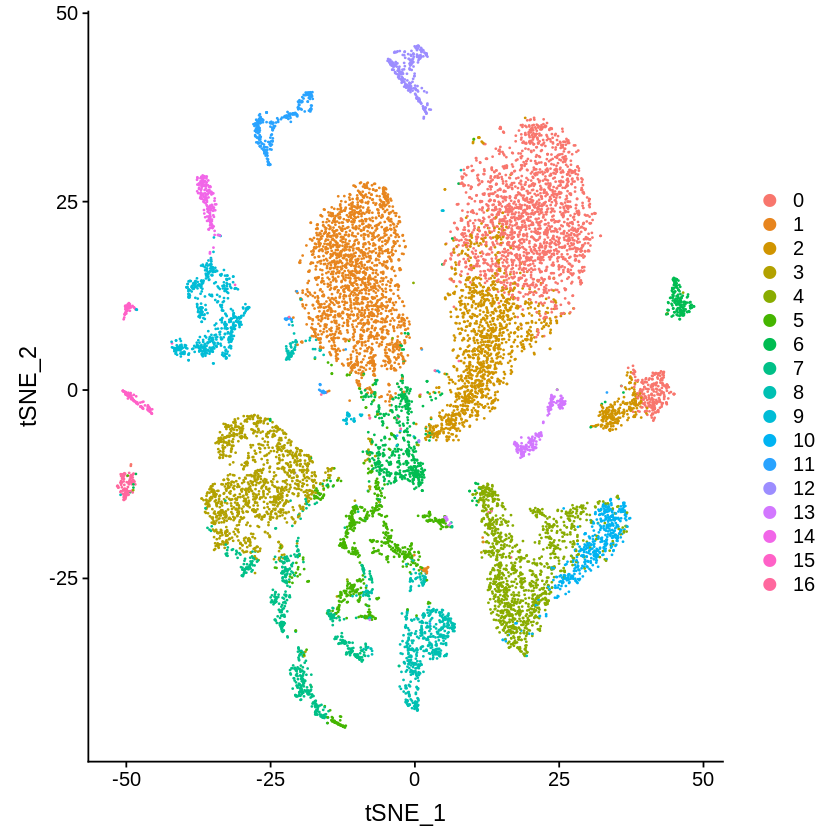

In [3]:
# switch to integrated assay. The variable features of this assay are
# automatically set during IntegrateData
DefaultAssay(object = data.integrated) <- "integrated"

# Run the standard workflow for visualization and clustering
data.integrated <- ScaleData(object = data.integrated, verbose = FALSE)
data.integrated <- RunPCA(object = data.integrated, npcs = 30, verbose = FALSE)
data.integrated <- RunTSNE(object = data.integrated, reduction = "pca", 
    dims = 1:30)
p1 <- DimPlot(object = data.integrated)
plot(p1)

# マーカーの発現を確認

Warning message:
“Could not find CD8A in the default search locations, found in RNA assay instead”

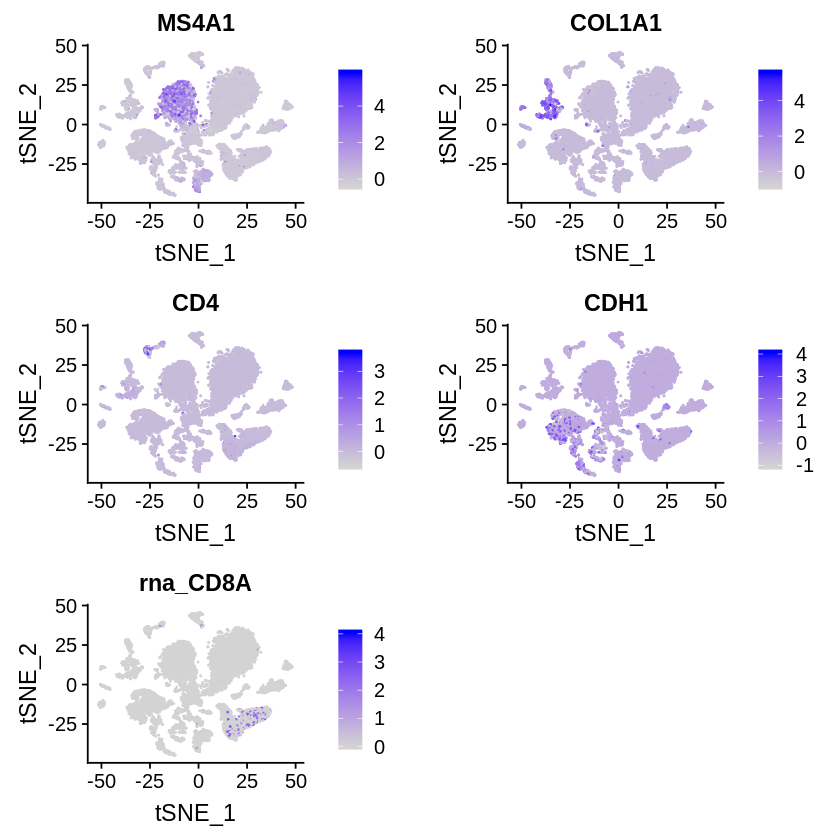

In [8]:
# MS4A1 -> B cell
# COL1A1-> fibroblast
# CD4 -> helper T cell
# CDH1 ->
# CD8A -> killer T cell
FeaturePlot(object = data.integrated, features = c("MS4A1", "COL1A1","CD4","CDH1","CD8A"), ncol = 2)
#, blend = TRUE, ncol = 3)

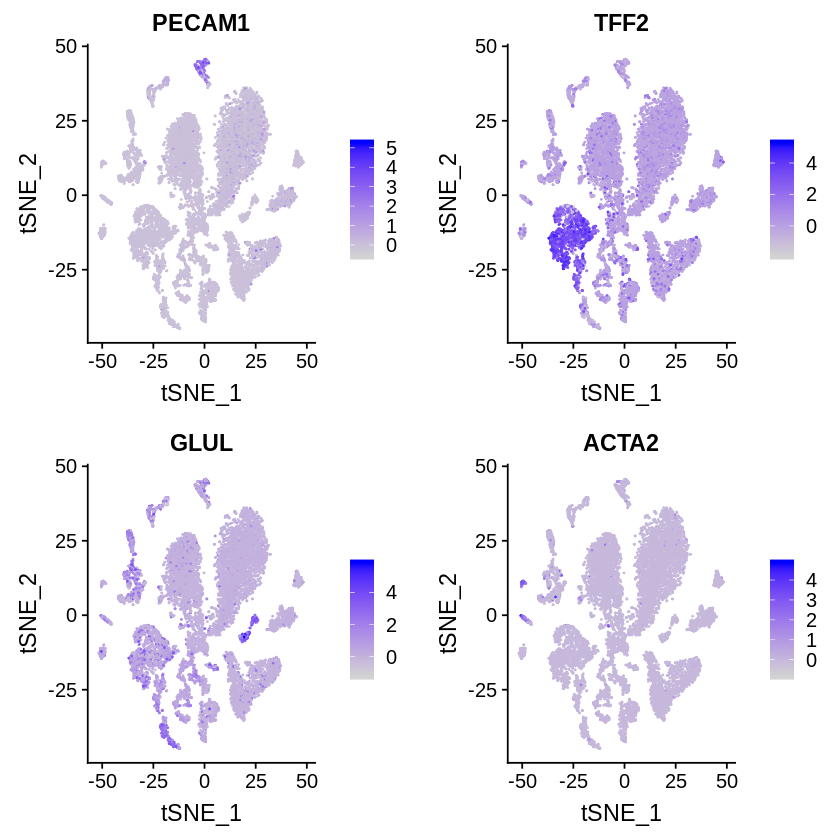

In [9]:
# PECAM1 -> lymphocyte?
# TFF2   -> gastric mucosa?
# GLUL   -> 
# ACTA2  -> sma抗体？
FeaturePlot(object = data.integrated, features = c("PECAM1","TFF2","GLUL","ACTA2"), ncol = 2)

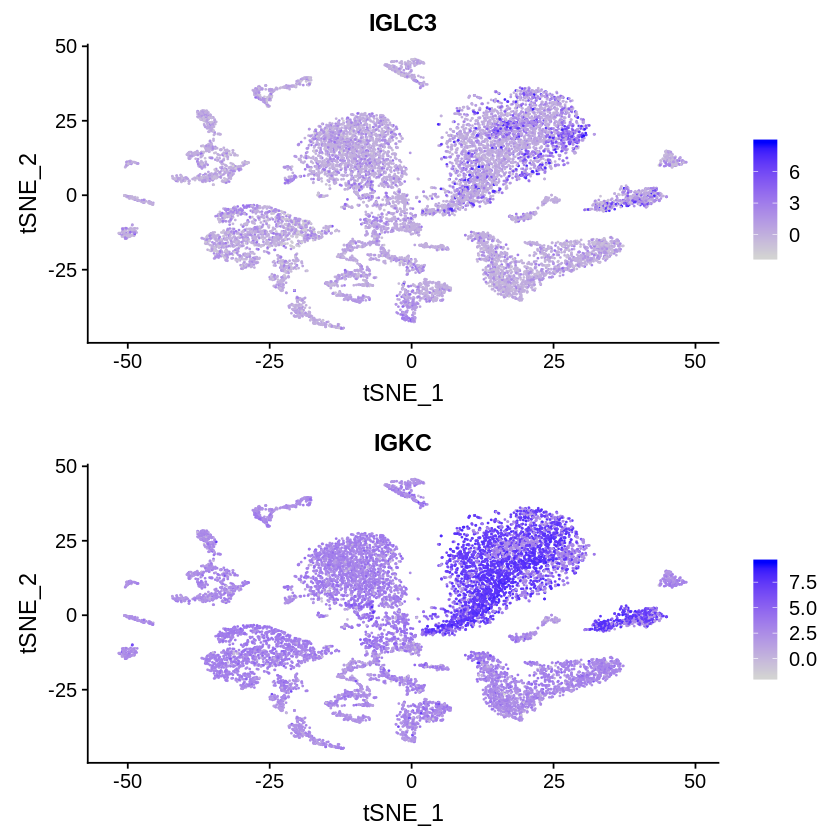

In [10]:
FeaturePlot(object = data.integrated, features = c("IGLC3","IGKC"),ncol=1)

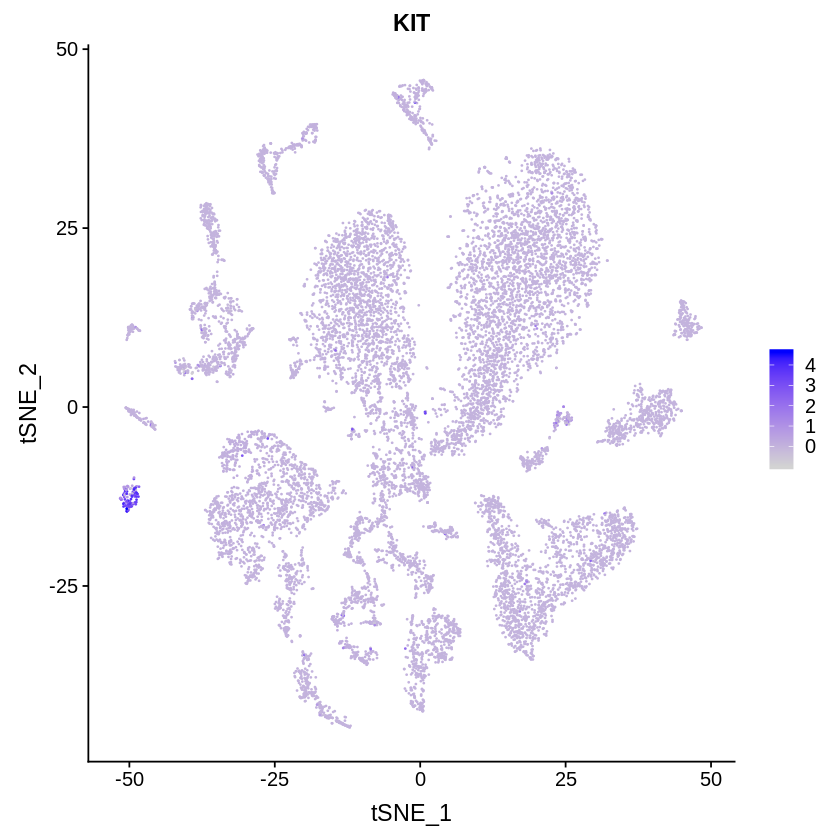

In [11]:
FeaturePlot(object = data.integrated, features = c("KIT"),ncol=2)

Warning message:
“Could not find CD8A in the default search locations, found in RNA assay instead”Warning message:
“Could not find PRF1 in the default search locations, found in RNA assay instead”

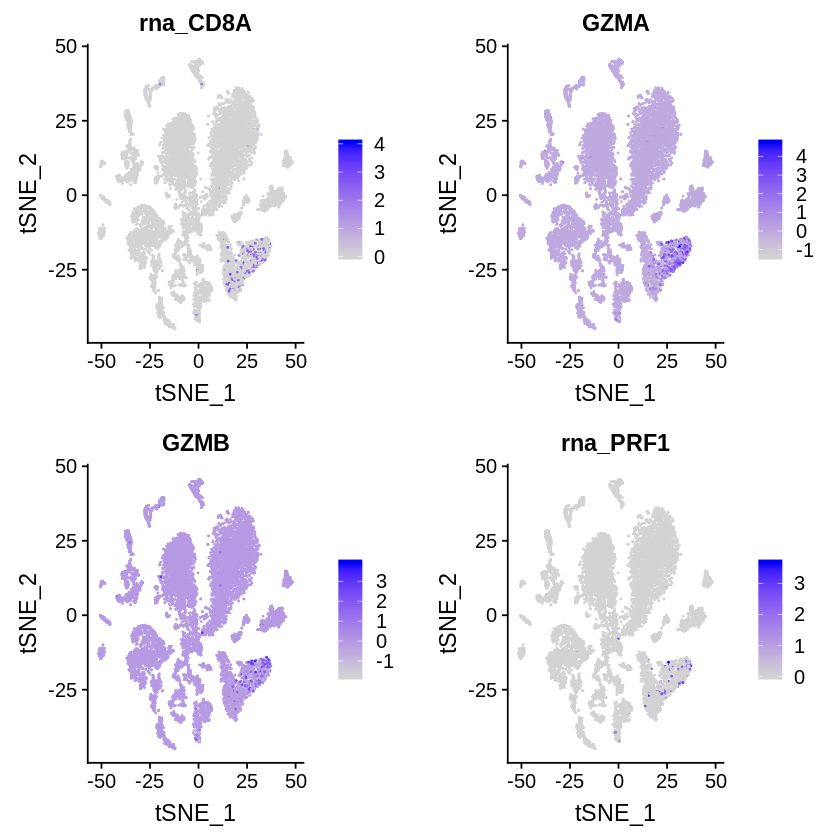

In [12]:
FeaturePlot(object = data.integrated, features = c("CD8A","GZMA","GZMB","PRF1"),ncol=2)

Warning message:
“Could not find KRT17 in the default search locations, found in RNA assay instead”Warning message:
“Could not find CDH17 in the default search locations, found in RNA assay instead”

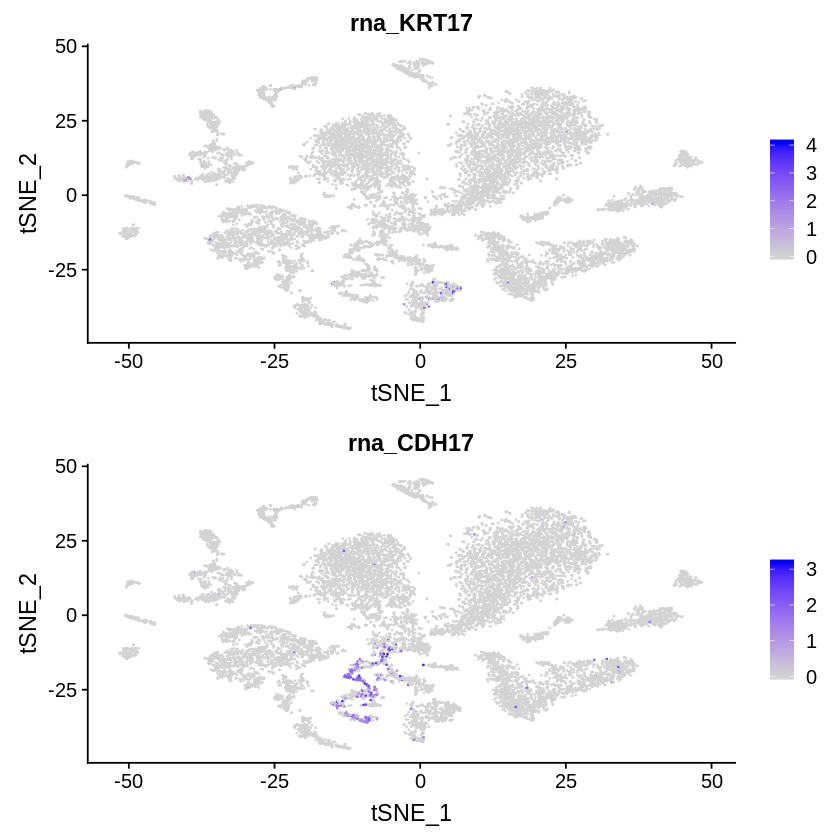

In [13]:
FeaturePlot(object = data.integrated, features = c("KRT17","CDH17"),ncol=1)

Cell names order match in 'mean.exp' and 'object@meta.data':
 adding gene set mean expression values in 'object@meta.data$gene.set.score'Cell names order match in 'mean.exp' and 'object@meta.data':
 adding gene set mean expression values in 'object@meta.data$gene.set.score'Cell names order match in 'mean.exp' and 'object@meta.data':
 adding gene set mean expression values in 'object@meta.data$gene.set.score'

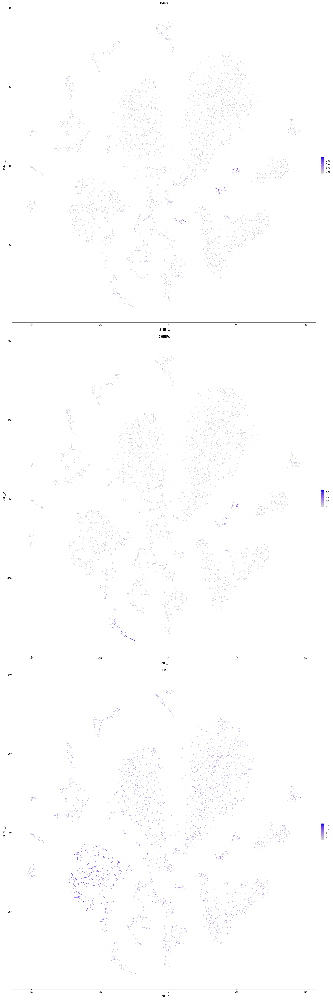

In [15]:
data.integrated$CHIEFs <- AddGeneSetScore(data.integrated,
                                   c("LIPF","PGC","PGA3","PGA4","PGA5"))
data.integrated$PARs <- AddGeneSetScore(data.integrated,
                                   c("ATP4B","GIF"))
data.integrated$Fs <- AddGeneSetScore(data.integrated,
                                   c("GKN1", "PSCA","MUC5AC"))

options(repr.plot.width=20, repr.plot.height=60)
FeaturePlot(object = data.integrated, features = c("PARs","CHIEFs","Fs"), ncol=1, pt.size = 0.1)

Warning message:
“Could not find OLFM4 in the default search locations, found in RNA assay instead”Warning message:
“Could not find SOX2 in the default search locations, found in RNA assay instead”Warning message:
“Could not find LGR5 in the default search locations, found in RNA assay instead”Warning message:
“Could not find CCKBR in the default search locations, found in RNA assay instead”

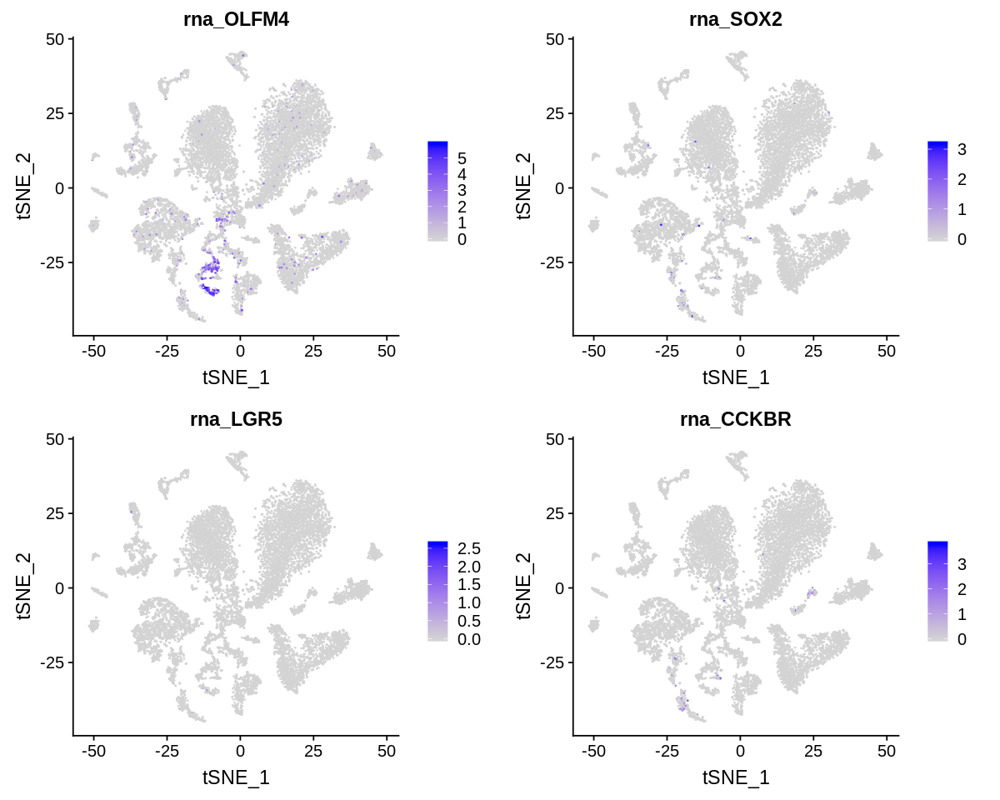

In [7]:
FeaturePlot(object = data.integrated, features = c('OLFM4','SOX2','LGR5','CCKBR'))

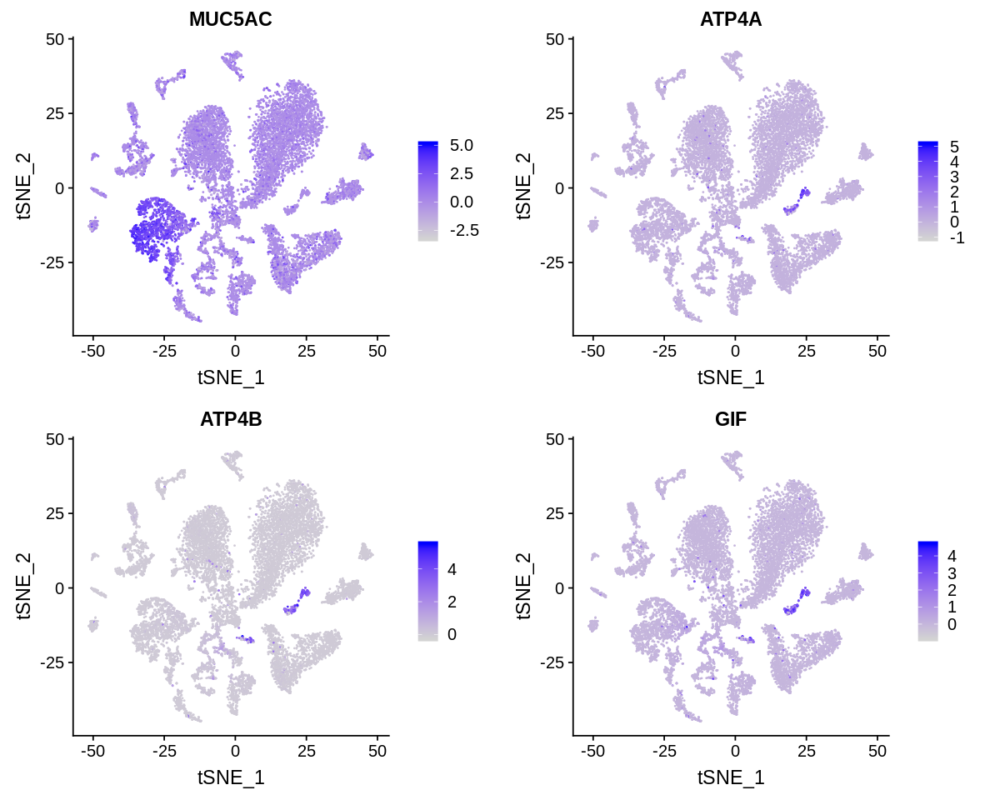

In [8]:
#epithelium
FeaturePlot(object = data.integrated, features = c("MUC5AC",'ATP4A',"ATP4B","GIF"))

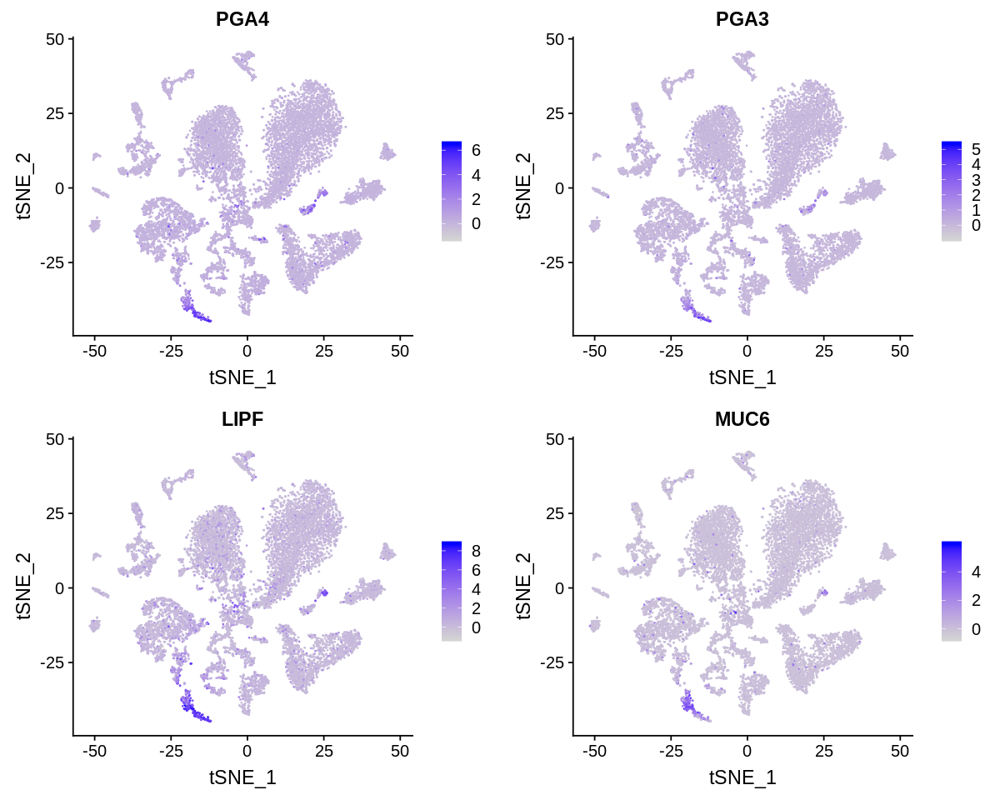

In [9]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('PGA4', "PGA3",'LIPF',"MUC6"), ncol = 2)

Warning message:
“Could not find CHGB in the default search locations, found in RNA assay instead”Warning message:
“Could not find TPH1 in the default search locations, found in RNA assay instead”Warning message in FetchData(object = object, vars = c(dims, features), cells = cells, :
“The following requested variables were not found: TAC1, NEUROG3”

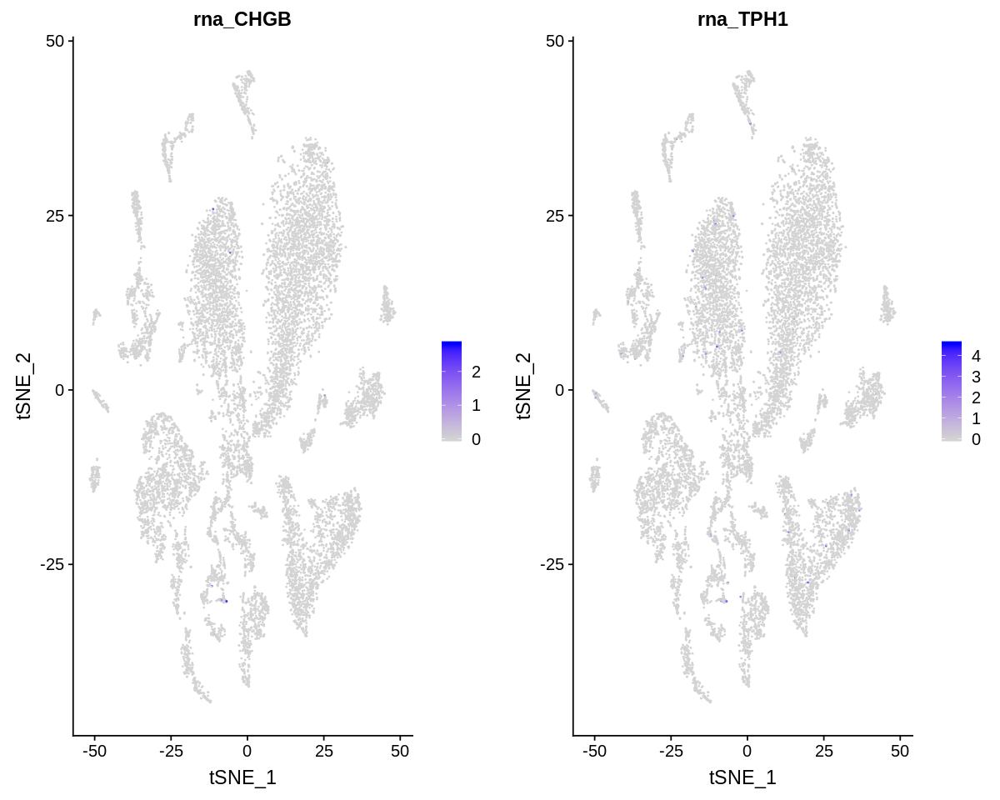

In [11]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('CHGB','TAC1','TPH1','NEUROG3'), ncol = 2)

Warning message:
“Could not find FABP1 in the default search locations, found in RNA assay instead”Warning message:
“Could not find CA1 in the default search locations, found in RNA assay instead”Warning message:
“Could not find VIL1 in the default search locations, found in RNA assay instead”

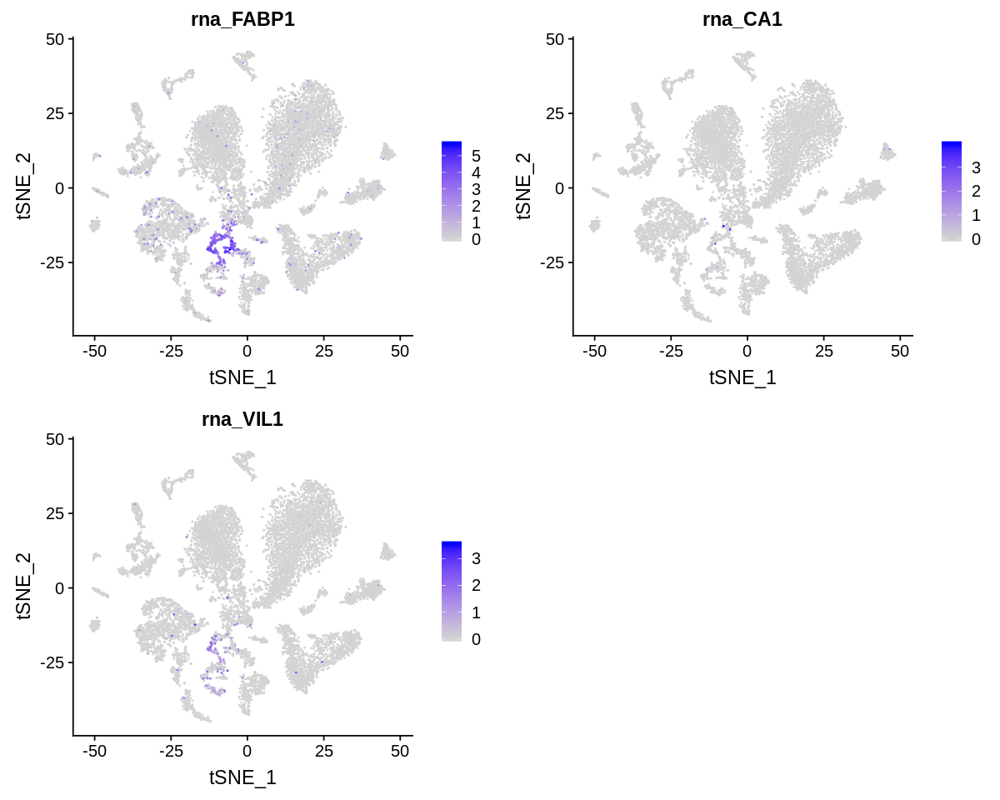

In [12]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('FABP1','CA1','VIL1'), ncol = 2)

Warning message:
“Could not find CDH17 in the default search locations, found in RNA assay instead”Warning message:
“Could not find CDX2 in the default search locations, found in RNA assay instead”Warning message:
“Could not find VIL1 in the default search locations, found in RNA assay instead”Warning message:
“Could not find MUC2 in the default search locations, found in RNA assay instead”

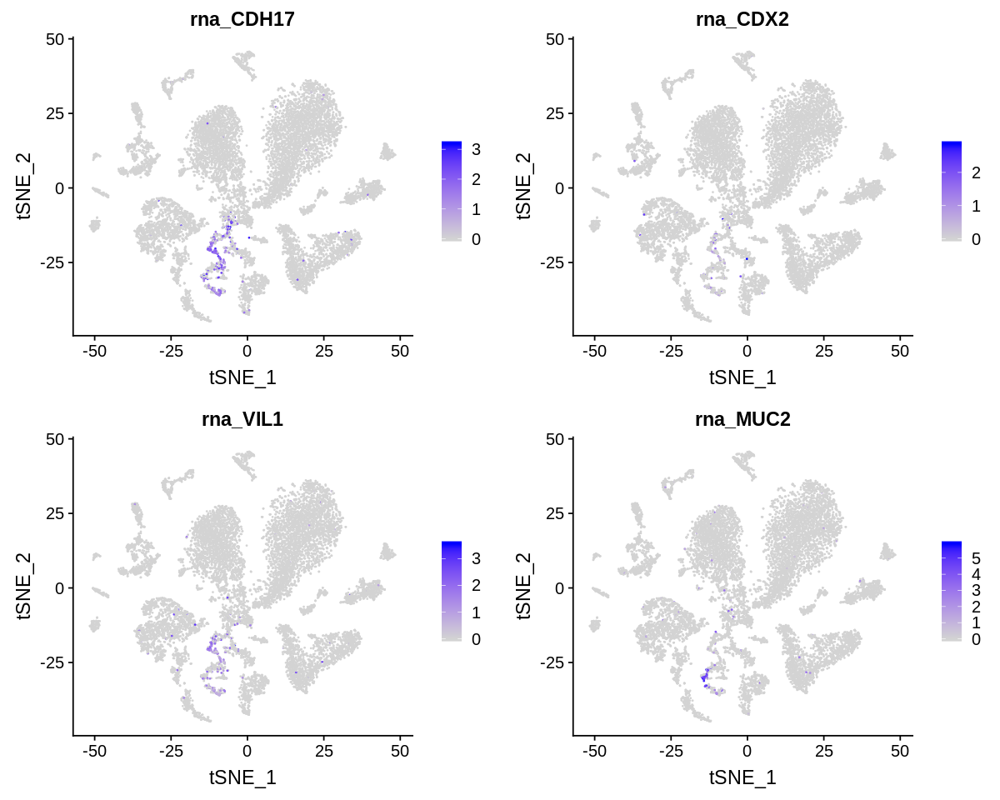

In [17]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('MUC2','SPINK4','TFF3','CHGA'), ncol = 2)

Warning message:
“Could not find HES6 in the default search locations, found in RNA assay instead”

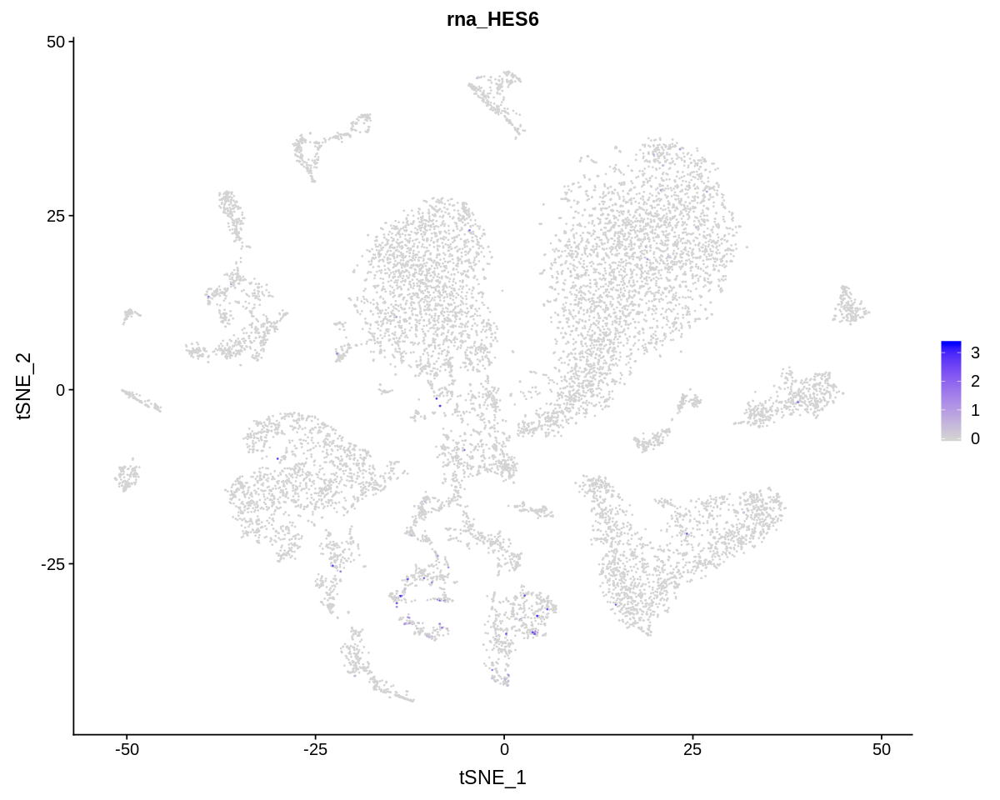

In [13]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c("HES6"), ncol = 2)

Warning message:
“Could not find GAST in the default search locations, found in RNA assay instead”Warning message:
“Could not find CCK in the default search locations, found in RNA assay instead”Warning message:
“Could not find SCT in the default search locations, found in RNA assay instead”Warning message:
“Could not find GIP in the default search locations, found in RNA assay instead”Warning message:
“Could not find MLN in the default search locations, found in RNA assay instead”Warning message:
“Could not find SST in the default search locations, found in RNA assay instead”Warning message:
“Could not find HRH1 in the default search locations, found in RNA assay instead”

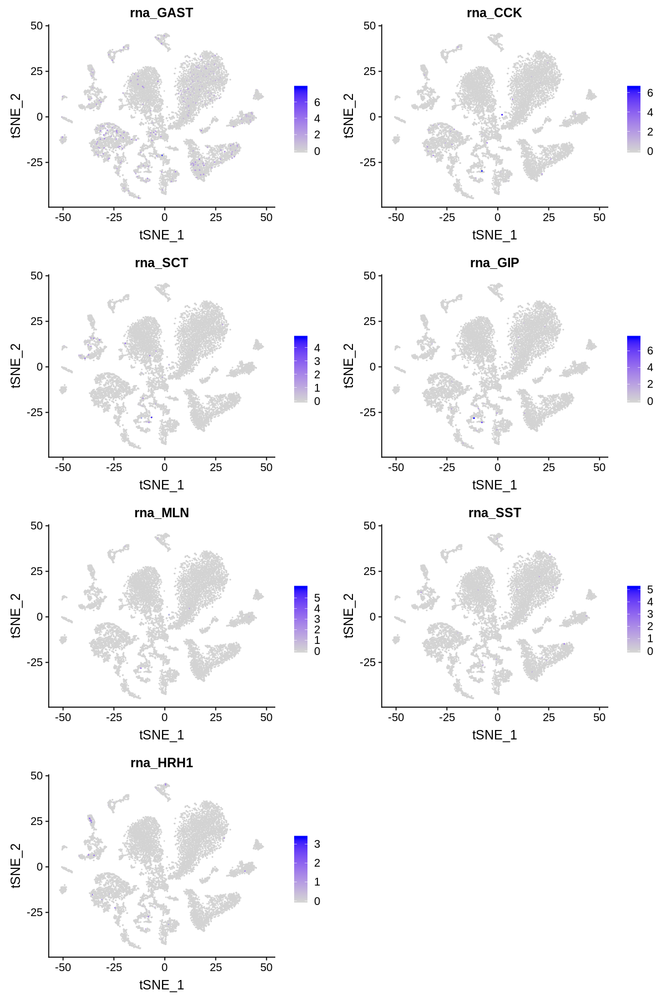

In [18]:
#endocrine
options(repr.plot.width=10, repr.plot.height=15)
FeaturePlot(object = data.integrated, features = c("GAST","CCK","SCT","GIP","MLN","SST","HRH1"), ncol = 2)

Warning message:
“Could not find MKI67 in the default search locations, found in RNA assay instead”

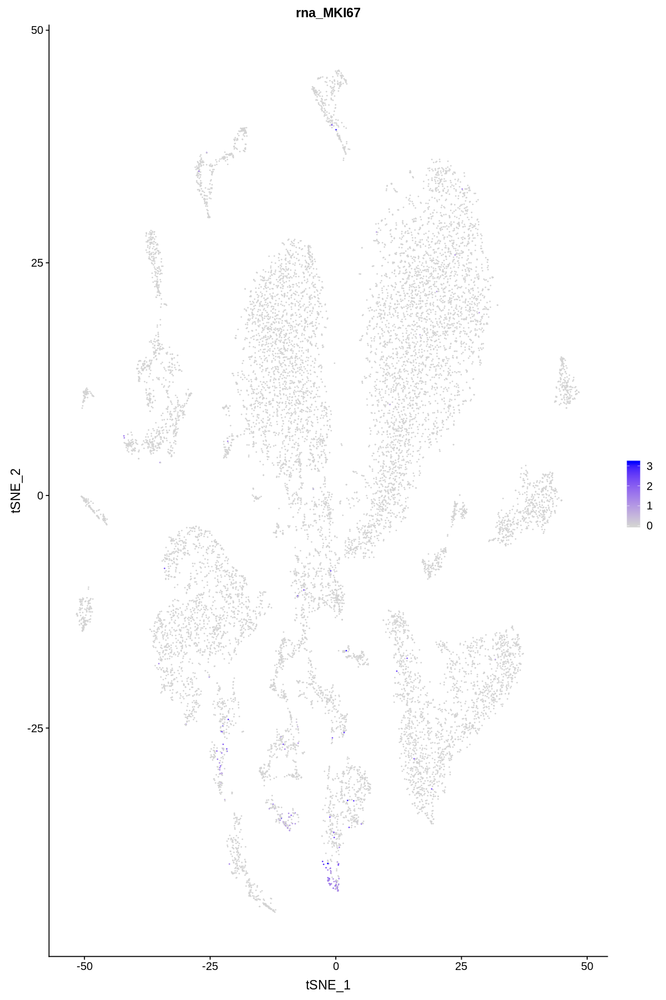

In [19]:
FeaturePlot(object = data.integrated, features = c("MKI67"),ncol=2)

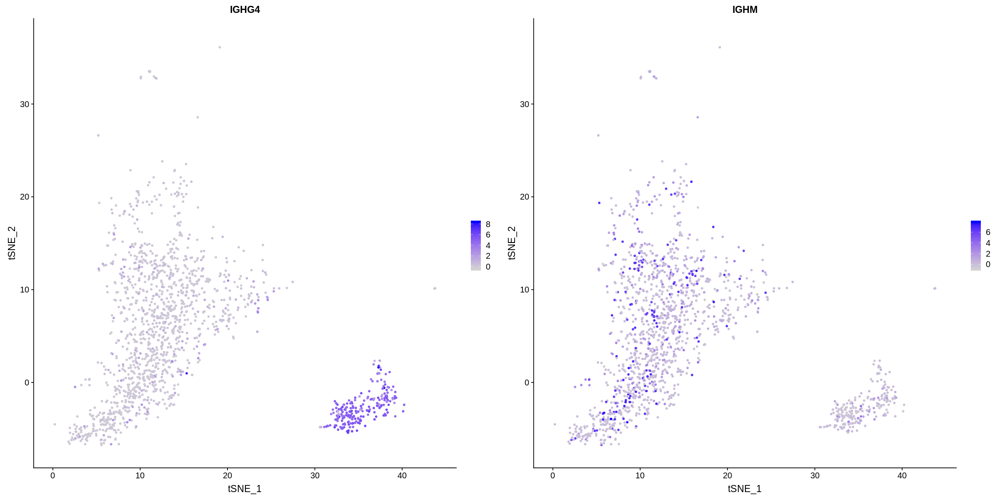

In [24]:
plasma1 <- subset(x = data.integrated, idents = c(2))
options(repr.plot.width=20, repr.plot.height=10)
FeaturePlot(object = plasma1, features = c('IGHG4','IGHM'))

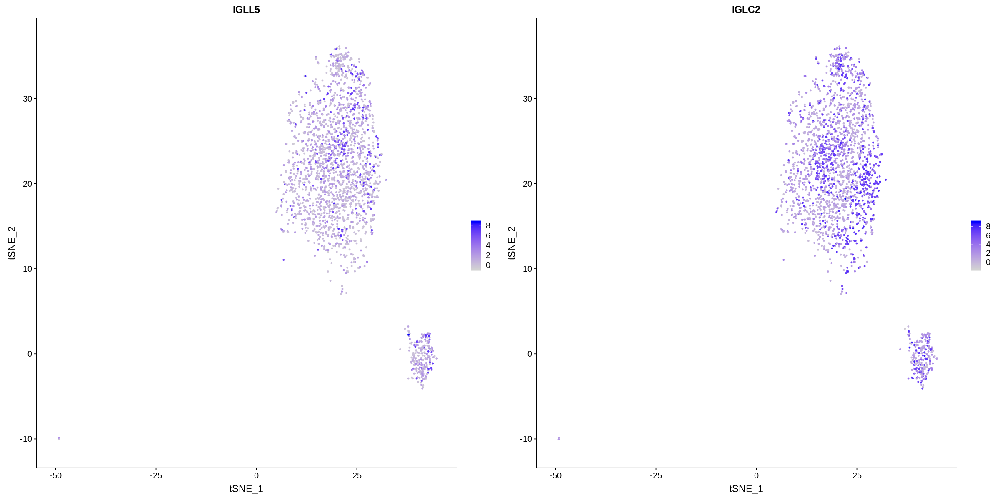

In [28]:
plasma0 <- subset(x = data.integrated, idents = c(0))
options(repr.plot.width=20, repr.plot.height=10)
FeaturePlot(object = plasma0, features = c('IGLL5','IGLC2'))

In [25]:
# FindAllMarkers
# The min.pct argument requires a feature to be detected at a minimum percentage in either of the two groups of cells, 
# and the thresh.test argument requires a feature to be differentially expressed (on average) 
# by some amount between the two groups. 
# You can set both of these to 0, but with a dramatic increase in time 
# - since this will test a large number of features that are unlikely to be highly discriminatory. 
# As another option to speed up these computations, max.cells.per.ident can be set. 
# This will downsample each identity class to have no more cells than whatever this is set to. 
# While there is generally going to be a loss in power, 
# the speed increases can be significiant and the most highly differentially expressed features will likely still rise to the top.

# 計算済み
all.markers <- FindAllMarkers(object = data.integrated, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0
Calculating cluster 1
Calculating cluster 2
Calculating cluster 3
Calculating cluster 4
Calculating cluster 5
Calculating cluster 6
Calculating cluster 7
Calculating cluster 8
Calculating cluster 9
Calculating cluster 10
Calculating cluster 11
Calculating cluster 12
Calculating cluster 13
Calculating cluster 14
Calculating cluster 15
Calculating cluster 16


In [26]:
all.markers %>% group_by(cluster) %>% top_n(n = 2, wt = avg_logFC)


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
0.000000e+00,3.200854,0.804,0.534,0.000000e+00,0,IGLL5
1.899487e-89,1.955050,0.879,0.727,3.798973e-86,0,IGLC2
0.000000e+00,2.285805,0.901,0.663,0.000000e+00,1,MS4A1
0.000000e+00,2.035833,0.944,0.737,0.000000e+00,1,CXCR4
5.172493e-17,2.045789,0.622,0.563,1.034499e-13,2,IGHG4
4.821820e-09,1.993035,0.552,0.518,9.643639e-06,2,IGHM
0.000000e+00,3.929198,0.975,0.456,0.000000e+00,3,GKN1
0.000000e+00,3.178672,0.979,0.444,0.000000e+00,3,TFF1
1.400368e-236,2.535013,0.733,0.544,2.800736e-233,4,KLRB1
1.502179e-190,2.208876,0.713,0.620,3.004359e-187,4,IL7R


In [6]:
# save(all.markers, file = "Normal_Total_gastric_all_markers.RData")
load("Normal_Total_gastric_all_markers.RData")

In [10]:
all.markers %>% group_by(cluster) %>% filter(cluster=='8') %>% top_n(n=50,wt=avg_logFC)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
9.865370e-293,2.0949087,0.917,0.428,1.973074e-289,8,PCLAF
2.001140e-276,2.1133559,0.932,0.605,4.002281e-273,8,STMN1
6.290559e-249,2.1018309,0.930,0.648,1.258112e-245,8,HMGB2
3.178401e-234,1.2753920,0.843,0.480,6.356803e-231,8,PTTG1
1.700640e-232,1.4890308,0.904,0.505,3.401279e-229,8,HMGA1
1.245880e-224,1.9198463,0.984,0.775,2.491759e-221,8,HMGN2
2.760657e-218,1.3554643,0.899,0.594,5.521314e-215,8,MARCKSL1
9.309642e-204,1.5930127,0.989,0.789,1.861928e-200,8,GAPDH
8.188815e-203,1.4152647,1.000,0.860,1.637763e-199,8,ACTB


In [5]:
all.markers %>% group_by(cluster) %>% filter(cluster=='8') %>% top_n(n = 100, wt = avg_logFC) -> cluster8

In [6]:
cluster8_gene <- cluster8$gene

In [9]:
dbs <- listEnrichrDbs()

In [11]:
dbs$libraryName

[1] "Genome_Browser_PWMs"                              
  [2] "TRANSFAC_and_JASPAR_PWMs"                         
  [3] "Transcription_Factor_PPIs"                        
  [4] "ChEA_2013"                                        
  [5] "Drug_Perturbations_from_GEO_2014"                 
  [6] "ENCODE_TF_ChIP-seq_2014"                          
  [7] "BioCarta_2013"                                    
  [8] "Reactome_2013"                                    
  [9] "WikiPathways_2013"                                
 [10] "Disease_Signatures_from_GEO_up_2014"              
 [11] "KEGG_2013"                                        
 [12] "TF-LOF_Expression_from_GEO"                       
 [13] "TargetScan_microRNA"                              
 [14] "PPI_Hub_Proteins"                                 
 [15] "GO_Molecular_Function_2015"                       
 [16] "GeneSigDB"                                        
 [17] "Chromosome_Location"                              
 [18] "Human_Gene_Atlas"                                 
 [19] "Mouse_Gene_Atlas"                                 
 [20] "GO_Cellular_Component_2015"                       
 [21] "GO_Biological_Process_2015"                       
 [22] "Human_Phenotype_Ontology"                         
 [23] "Epigenomics_Roadmap_HM_ChIP-seq"                  
 [24] "KEA_2013"                                         
 [25] "NURSA_Human_Endogenous_Complexome"                
 [26] "CORUM"                                            
 [27] "SILAC_Phosphoproteomics"                          
 [28] "MGI_Mammalian_Phenotype_Level_3"                  
 [29] "MGI_Mammalian_Phenotype_Level_4"                  
 [30] "Old_CMAP_up"                                      
 [31] "Old_CMAP_down"                                    
 [32] "OMIM_Disease"                                     
 [33] "OMIM_Expanded"                                    
 [34] "VirusMINT"                                        
 [35] "MSigDB_Computational"                             
 [36] "MSigDB_Oncogenic_Signatures"                      
 [37] "Disease_Signatures_from_GEO_down_2014"            
 [38] "Virus_Perturbations_from_GEO_up"                  
 [39] "Virus_Perturbations_from_GEO_down"                
 [40] "Cancer_Cell_Line_Encyclopedia"                    
 [41] "NCI-60_Cancer_Cell_Lines"                         
 [42] "Tissue_Protein_Expression_from_ProteomicsDB"      
 [43] "Tissue_Protein_Expression_from_Human_Proteome_Map"
 [44] "HMDB_Metabolites"                                 
 [45] "Pfam_InterPro_Domains"                            
 [46] "GO_Biological_Process_2013"                       
 [47] "GO_Cellular_Component_2013"                       
 [48] "GO_Molecular_Function_2013"                       
 [49] "Allen_Brain_Atlas_up"                             
 [50] "ENCODE_TF_ChIP-seq_2015"                          
 [51] "ENCODE_Histone_Modifications_2015"                
 [52] "Phosphatase_Substrates_from_DEPOD"                
 [53] "Allen_Brain_Atlas_down"                           
 [54] "ENCODE_Histone_Modifications_2013"                
 [55] "Achilles_fitness_increase"                        
 [56] "Achilles_fitness_decrease"                        
 [57] "MGI_Mammalian_Phenotype_2013"                     
 [58] "BioCarta_2015"                                    
 [59] "HumanCyc_2015"                                    
 [60] "KEGG_2015"                                        
 [61] "NCI-Nature_2015"                                  
 [62] "Panther_2015"                                     
 [63] "WikiPathways_2015"                                
 [64] "Reactome_2015"                                    
 [65] "ESCAPE"                                           
 [66] "HomoloGene"                                       
 [67] "Disease_Perturbations_from_GEO_down"              
 [68] "Disease_Perturbations_from_GEO_up"                
 [69] "Drug_Perturbations_from_GEO_down"                 


In [12]:
dbs <- c("GO_Molecular_Function_2018", "GO_Cellular_Component_2018", "GO_Biological_Process_2018")

In [39]:
enriched <- enrichr(cluster8_gene[1:50], dbs)

Uploading data to Enrichr... Done.
  Querying GO_Molecular_Function_2018... Done.
  Querying GO_Cellular_Component_2018... Done.
  Querying GO_Biological_Process_2018... Done.
Parsing results... Done.


In [46]:
head(cluster8_gene)

[1] "PCLAF" "STMN1" "HMGB2" "PTTG1" "LRMP"  "HMGA1"

In [43]:
head(enriched$GO_Biological_Process_2018)

Term,Overlap,P.value,Adjusted.P.value,Old.P.value,Old.Adjusted.P.value,Z.score,Combined.Score,Genes
V(D)J recombination (GO:0033151),2/8,1.698692e-04,0.010733725,4.184160e-04,0.02420561,-3.282466,28.49338,HMGB2;HMGB1
establishment of integrated proviral latency (GO:0075713),2/9,2.180541e-04,0.010733725,5.103862e-04,0.02420561,-2.879384,24.27542,HMGA1;PPIA
establishment of viral latency (GO:0019043),2/10,2.721319e-04,0.010776425,6.112527e-04,0.02420561,-2.899417,23.80196,HMGA1;PPIA
DNA ligation (GO:0006266),3/19,1.385012e-05,0.003074998,4.146264e-05,0.01421548,-2.075158,23.21524,PCNA;HMGB2;HMGB1
neutrophil degranulation (GO:0043312),8/480,2.300032e-05,0.003074998,1.130060e-04,0.01421548,-2.014438,21.51420,CCT2;HSP90AA1;FABP5;TUBB;COTL1;LRMP;HMGB1;PPIA
neutrophil mediated immunity (GO:0002446),8/488,2.588382e-05,0.003074998,1.264680e-04,0.01421548,-1.940249,20.49270,CCT2;HSP90AA1;FABP5;TUBB;COTL1;LRMP;HMGB1;PPIA


In [44]:
head(enriched$GO_Cellular_Component_2018)

Term,Overlap,P.value,Adjusted.P.value,Old.P.value,Old.Adjusted.P.value,Z.score,Combined.Score,Genes
U12-type spliceosomal complex (GO:0005689),3/28,4.608807e-05,0.002373536,0.0003183654,0.02287582,-1.987621,19.84631,SNRPG;YBX1;SNRNP25
ficolin-1-rich granule lumen (GO:1904813),4/124,2.600084e-04,0.006414335,0.0022471818,0.05468752,-2.228743,18.39782,HSP90AA1;COTL1;HMGB1;PPIA
MHC class II protein complex (GO:0042613),2/15,6.299187e-04,0.009007412,0.0024280271,0.05468752,-2.357004,17.37093,HLA-DMA;HLA-DRA
vacuolar lumen (GO:0005775),4/162,7.147177e-04,0.009007412,0.0057089610,0.06533589,-2.128984,15.42156,CCT2;HSP90AA1;FABP5;TUBB
secretory granule lumen (GO:0034774),7/318,1.336342e-05,0.001376432,0.0004441907,0.02287582,-1.306153,14.65894,CCT2;HSP90AA1;FABP5;TUBB;COTL1;HMGB1;PPIA
MHC protein complex (GO:0042611),2/19,1.019333e-03,0.009544660,0.0037080957,0.06312790,-2.019706,13.91296,HLA-DMA;HLA-DRA


In [45]:
head(enriched$GO_Molecular_Function_2018)

Term,Overlap,P.value,Adjusted.P.value,Old.P.value,Old.Adjusted.P.value,Z.score,Combined.Score,Genes
DNA polymerase binding (GO:0070182),3/17,9.753704e-06,4.226605e-04,3.653281e-05,0.0015830886,-2.363022,27.26423,HSP90AA1;PCNA;HMGB1
MHC class II protein complex binding (GO:0023026),3/17,9.753704e-06,4.226605e-04,3.653281e-05,0.0015830886,-2.190025,25.26821,HSP90AA1;HLA-DMA;HLA-DRA
MHC protein complex binding (GO:0023023),3/20,1.626558e-05,5.286313e-04,5.636668e-05,0.0018319170,-2.240878,24.70895,HSP90AA1;HLA-DMA;HLA-DRA
RAGE receptor binding (GO:0050786),2/10,2.721319e-04,5.053879e-03,6.875892e-04,0.0127695141,-2.972758,24.40403,HMGB2;HMGB1
RNA binding (GO:0003723),16/1388,1.368306e-07,1.778797e-05,3.581263e-06,0.0004655642,-1.372510,21.69187,SLBP;DUT;HSP90AA1;HMGB2;YBX1;HMGB1;DEK;CORO1A;SNRPG;HMGN2;SLC25A5;PFN1;KPNA2;PPIA;RAN;METAP2
four-way junction DNA binding (GO:0000400),2/17,8.132914e-04,1.079582e-02,1.755673e-03,0.0281188389,-2.303290,16.38658,HMGB2;HMGB1


Warning message:
“Could not find CD55 in the default search locations, found in RNA assay instead”

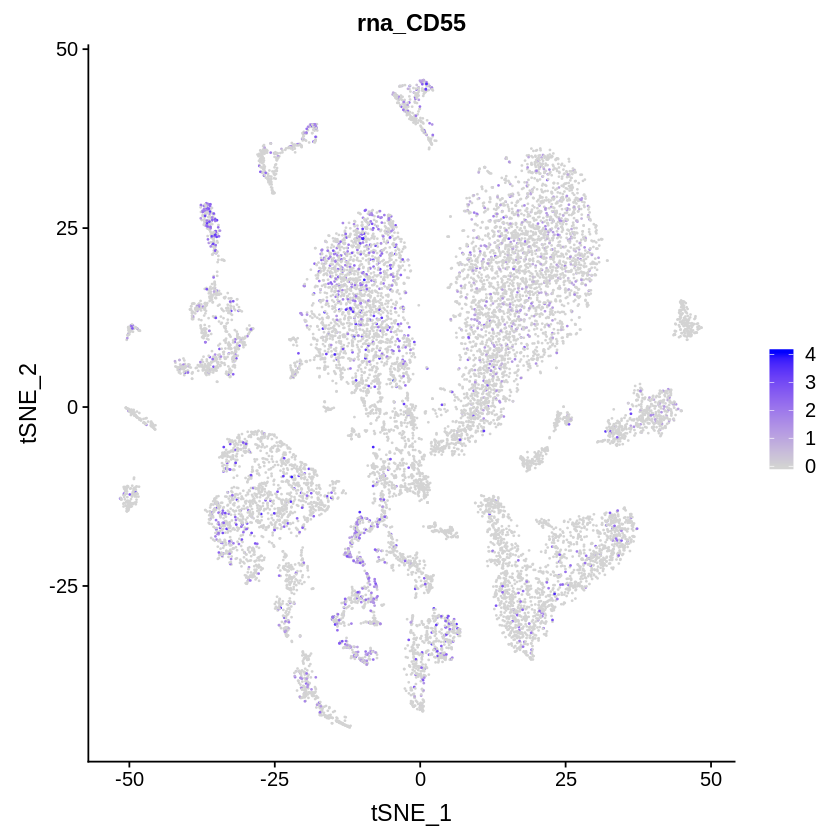

In [38]:
FeaturePlot(object = data.integrated, features = c('CD55'))

In [86]:
top5_marker

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
0.000000e+00,3.200854,0.804,0.534,0.000000e+00,0,IGLL5
0.000000e+00,1.755687,1.000,0.956,0.000000e+00,0,JCHAIN
0.000000e+00,1.693054,1.000,0.939,0.000000e+00,0,IGHA1
7.369599e-144,1.667906,0.765,0.560,1.473920e-140,0,IGLC3
1.899487e-89,1.955050,0.879,0.727,3.798973e-86,0,IGLC2
0.000000e+00,2.285805,0.901,0.663,0.000000e+00,1,MS4A1
0.000000e+00,2.035833,0.944,0.737,0.000000e+00,1,CXCR4
0.000000e+00,1.988921,0.991,0.745,0.000000e+00,1,HLA-DRA
0.000000e+00,1.884942,0.798,0.591,0.000000e+00,1,VPREB3
0.000000e+00,1.768963,0.907,0.643,0.000000e+00,1,CD52


In [90]:
for (i in 0:15){
    print(top5_marker$gene[(5*i+1):(5*i+5)])
    }

[1] "IGLL5"  "JCHAIN" "IGHA1"  "IGLC3"  "IGLC2" 
[1] "MS4A1"   "CXCR4"   "HLA-DRA" "VPREB3"  "CD52"   
[1] "IGHA2" "IGHG1" "IGHG3" "IGHG4" "IGHM" 
[1] "GKN1"   "TFF1"   "GKN2"   "TFF2"   "MUC5AC"
[1] "KLRB1" "FYB1"  "CD2"   "IL7R"  "CD3D" 
[1] "CHGA" "PGA5" "PGC"  "PGA4" "LIPF"
[1] "MT-CO3"  "MT-CO2"  "MT-CO1"  "MT-ATP6" "HBA2"   
[1] "LIPF" "AGR2" "PGC"  "LYZ"  "MUC6"
[1] "PCLAF" "STMN1" "HMGB2" "HMGN2" "H2AFZ"
[1] "COL3A1" "COL1A2" "COL1A1" "POSTN"  "CXCL14"
[1] "CCL5"  "CCL4"  "GZMK"  "KLRB1" "NKG7" 
[1] "HLA-DPA1" "C1QB"     "TYROBP"   "C1QA"     "SLC40A1" 
[1] "SPARCL1" "IGFBP7"  "PLVAP"   "EPAS1"   "GNG11"  
[1] "CKB"     "ALDH1A1" "ATP4B"   "GIF"     "ATP4A"  
[1] "FBLN1"  "DCN"    "FN1"    "CFD"    "IGFBP6"
[1] "MYL9"  "MYH11" "TAGLN" "ADIRF" "RGS5" 


In [91]:
top5_marker$gene[80:85]

[1] "RGS5"   "TPSAB1" "MS4A2"  "CPA3"   "TPSB2"  "KIT"

In [54]:
for (i in 0:5){
print(c(top2_marker$gene[(1+i*2):(2+i*2)]))}

[1] "IGLL5" "IGLC2"
[1] "MS4A1" "CXCR4"
[1] "IGHG4" "IGHM" 
[1] "GKN1" "TFF1"
[1] "KLRB1" "IL7R" 
[1] "PGA5" "PGC" 


In [61]:
paste("I", 1)

[1] "I 1"

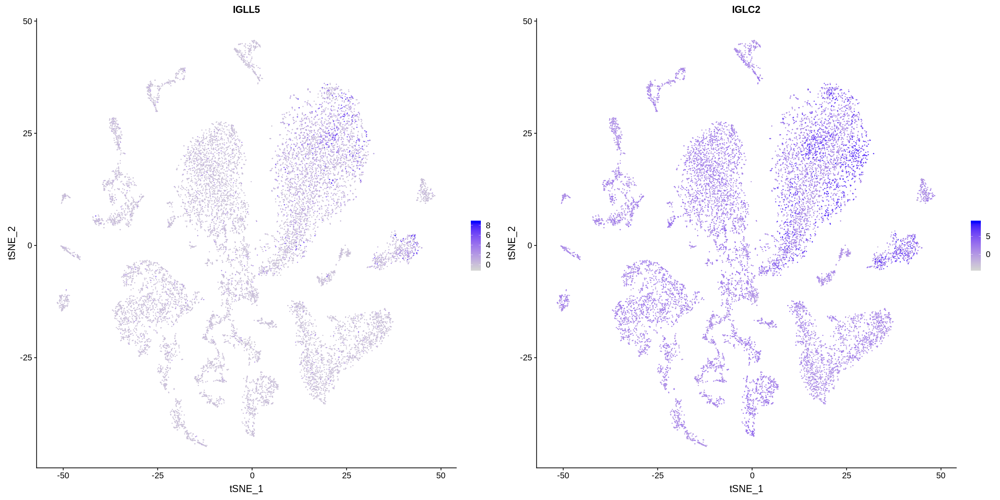

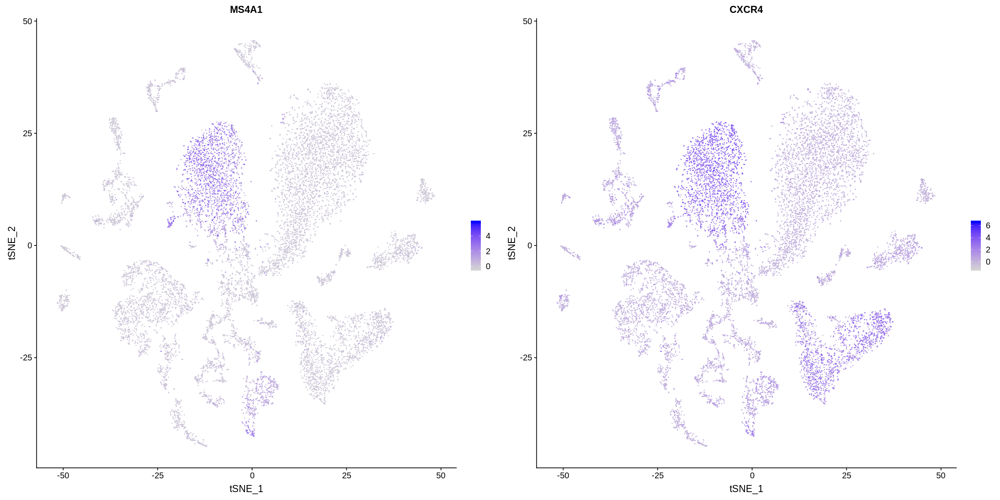

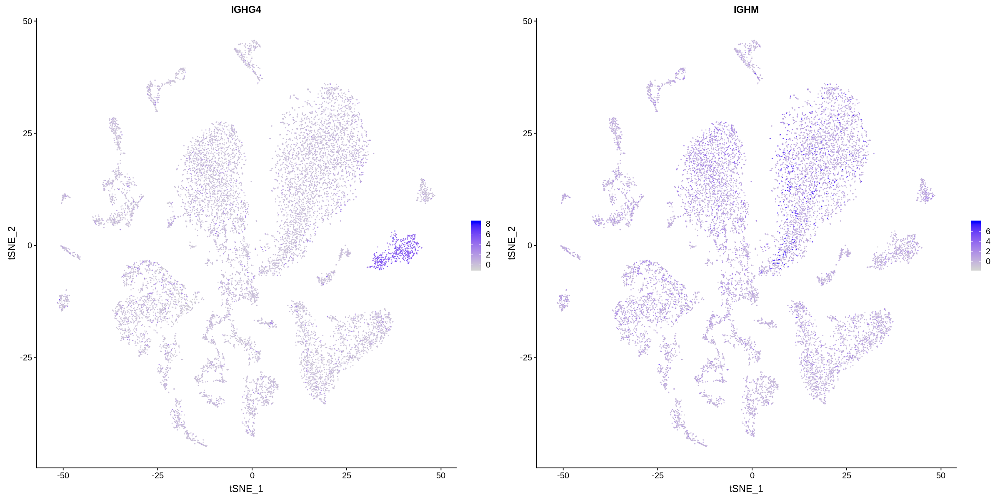

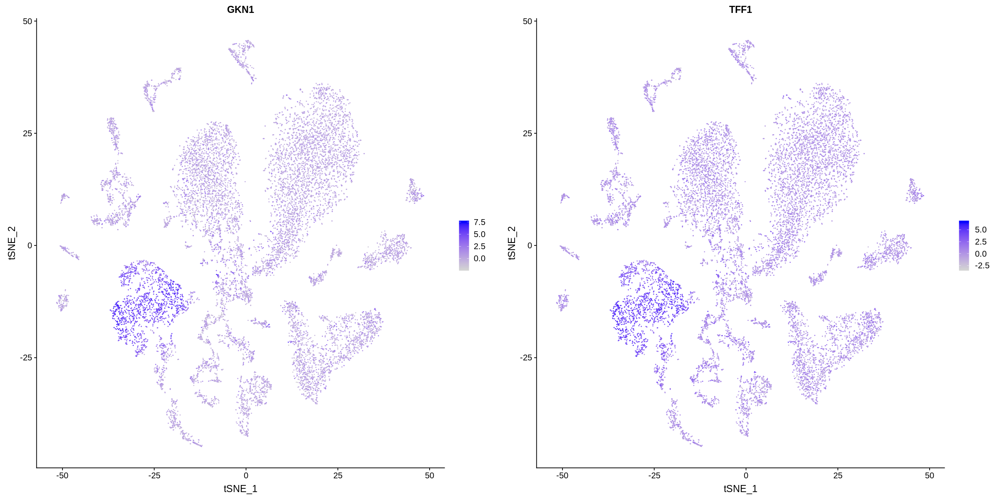

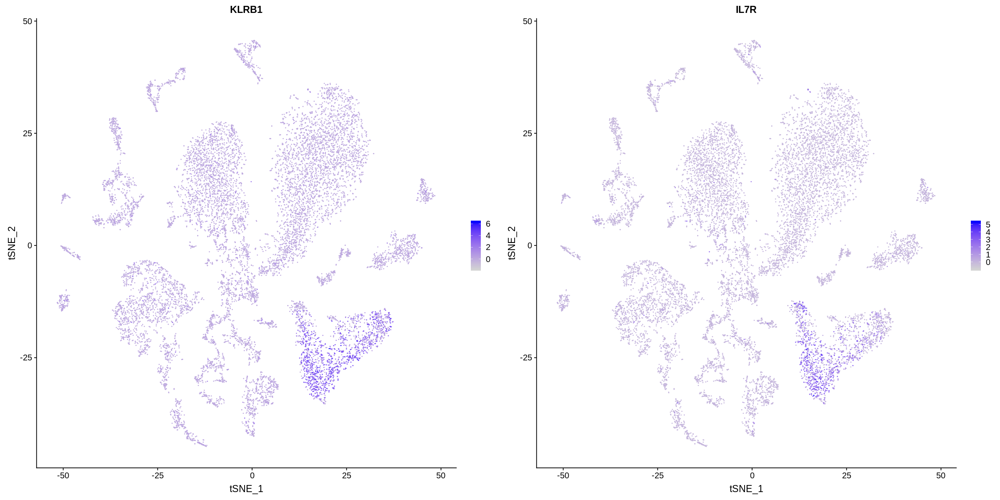

...

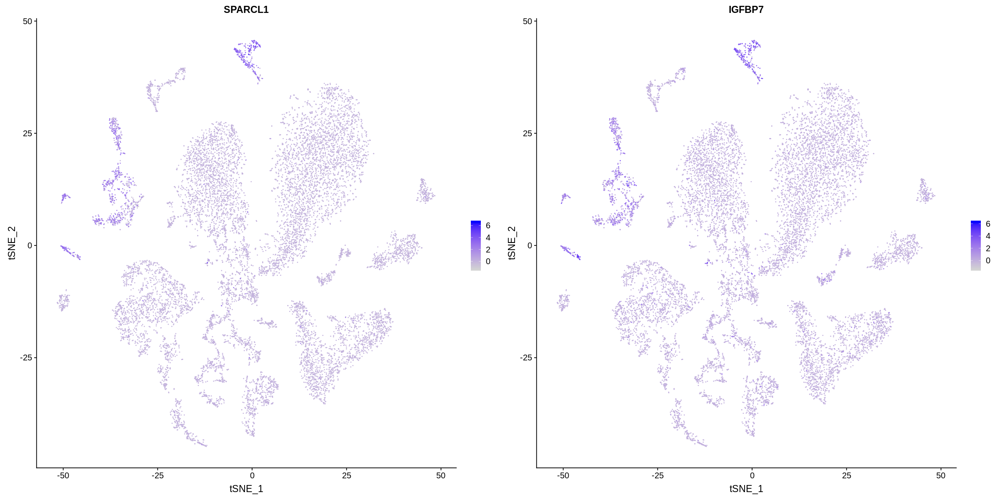

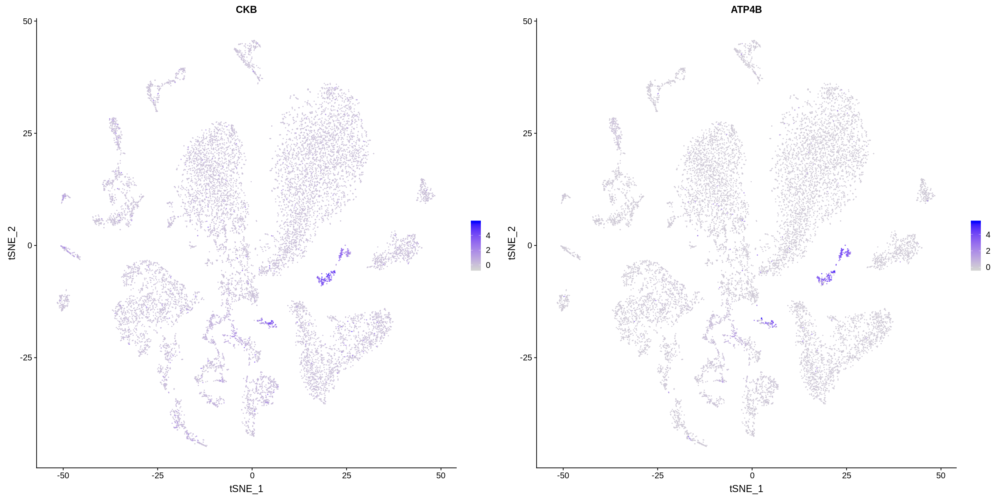

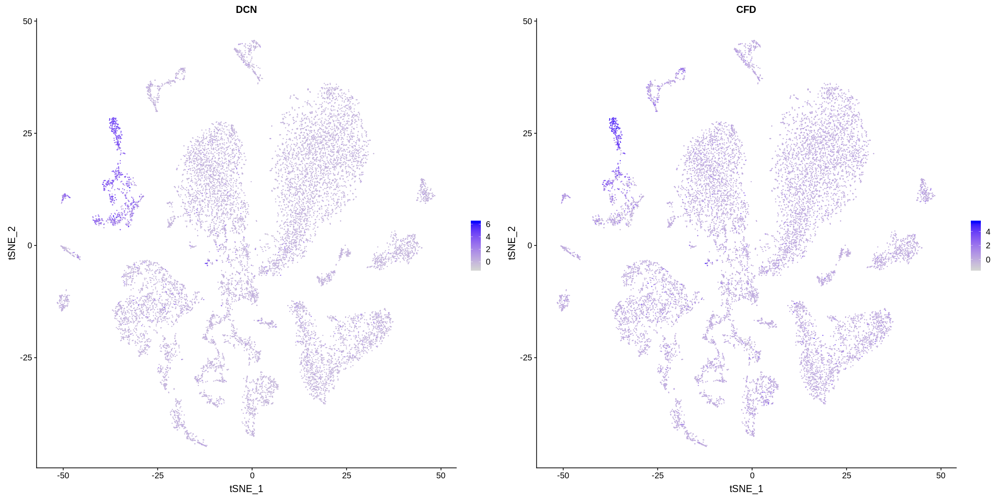

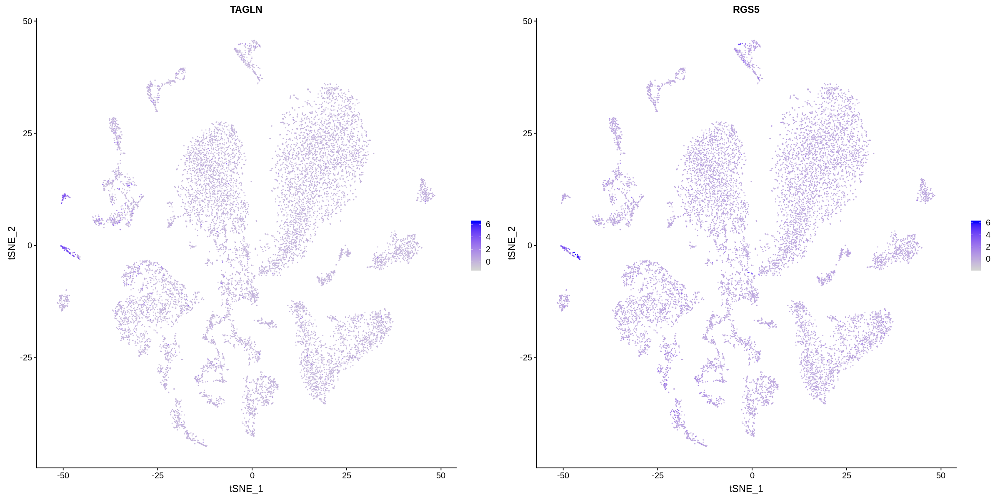

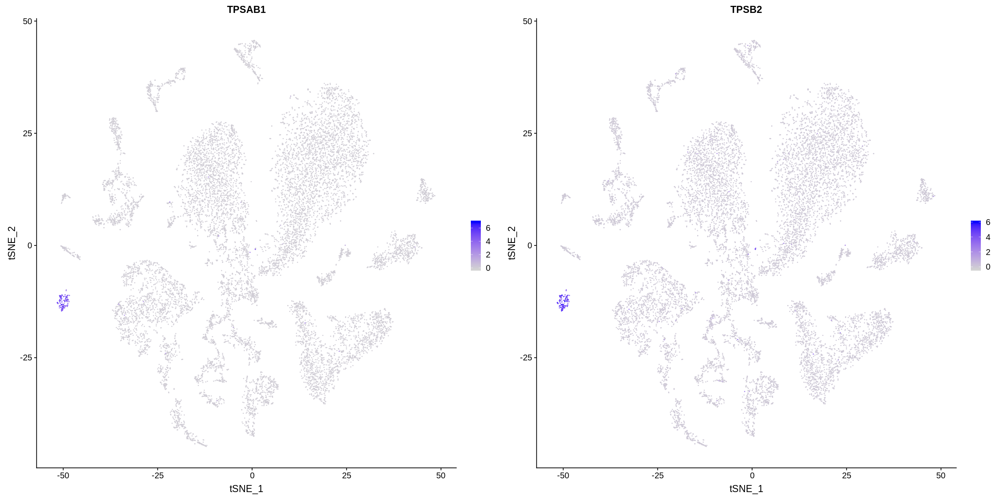

In [63]:
for (i in 0:16){
    p1 <- FeaturePlot(object = data.integrated, features = top2_marker$gene[(2*i+1):(2*i+2)])
}

In [77]:
p1 <- DimPlot(object = data.integrated)
png("plot.png", height = 960*5, width = 960*5, res=144*5)
plot(p1)
dev.off()

png 
  2

# 胃の細胞の種類
1. 表層粘液細胞
2. 副細胞
3. 壁細胞
4. 主細胞
5. 線維芽細胞
6. T細胞
7. B細胞
8. 内分泌細胞？(基底顆粒細胞?)
9. 血管細胞
10. 単層円柱上皮？
11. 筋細胞？

In [50]:
stomach <- subset(x = data.integrated, idents = c(3,5,7,13))

In [1]:
p2 <- DimPlot(object = stomach)
plot(p2)

ERROR: Error in DimPlot(object = stomach): could not find function "DimPlot"
